In [4]:
import torch
from pytorch3d.io import load_obj, save_obj,load_objs_as_meshes
from pytorch3d.structures import Meshes
from pytorch3d.utils import ico_sphere,torus
from pytorch3d.ops import sample_points_from_meshes
from pytorch3d.loss import (
    chamfer_distance,
    mesh_edge_loss,
    mesh_laplacian_smoothing,
    mesh_normal_consistency,
)
import numpy as np
from tqdm.notebook import tqdm
%matplotlib notebook
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib as mpl
import plotly.graph_objects as go
import numpy as np

mpl.rcParams['savefig.dpi'] = 80
mpl.rcParams['figure.dpi'] = 80

from plotly.subplots import make_subplots
torch.manual_seed(777)

# Set the device
if torch.cuda.is_available():
    device = torch.device("cuda:0")
else:
    device = torch.device("cpu")
    print("WARNING: CPU only, this will be slow!")


def plotly_submeshes(verts,faces,size):
    specs=[[{"type": "mesh3d"} for i in range(size[1])] for j in range(size[0])]
    fig = make_subplots(size[0],size[1],specs=specs)
    for j in range(size[0]):
        for i in range(size[1]):
            fig.add_trace(go.Mesh3d(x=verts[j][i][:,0],y=verts[j][i][:,1],z=verts[j][i][:,2],i=faces[j][i][:,0],j=faces[j][i][:,1],k=faces[j][i][:,2]),row=j+1,col=i+1)
    return fig

def plot_pointcloud(mesh, title=""):
    # Sample points uniformly from the surface of the mesh.
    points = sample_points_from_meshes(mesh, 5000)
    x, y, z = points.clone().detach().cpu().squeeze().unbind(1)
    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter3D(x, z, -y)
    ax.set_xlabel('x')
    ax.set_ylabel('z')
    ax.set_zlabel('y')
    ax.set_title(title)
    ax.view_init(190, 30)
    plt.show()


def RMSprop_opt(src_mesh,trg_mesh,chamfer,edge,normal,laplacian,iterations,lr,momentum):
    # The shape of the deform parameters is equal to the total number of vertices in src_mesh
    deform_verts = torch.full(src_mesh.verts_packed().shape, 0.0, device=device, requires_grad=True)
    # The optimizer
    optimizer = torch.optim.RMSprop([deform_verts], lr=lr, momentum=momentum)
    # Number of optimization steps
    Niter = iterations
    # Weight for the chamfer loss
    w_chamfer = chamfer
    # Weight for mesh edge loss
    w_edge = edge
    # Weight for mesh normal consistency
    w_normal = normal
    # Weight for mesh laplacian smoothing
    w_laplacian = laplacian
    # Plot period for the losses
    plot_period = 1000
    loop = tqdm(range(Niter))

    chamfer_losses = []
    laplacian_losses = []
    edge_losses = []
    normal_losses = []
    total_losses = []
    %matplotlib inline

    for i in loop:
        # Initialize optimizer
        optimizer.zero_grad()

        # Deform the mesh
        new_src_mesh = src_mesh.offset_verts(deform_verts)

        # We sample 5k points from the surface of each mesh
        sample_trg = sample_points_from_meshes(trg_mesh, 5000)
        sample_src = sample_points_from_meshes(new_src_mesh, 5000)

        # We compare the two sets of pointclouds by computing (a) the chamfer loss
        loss_chamfer, _ = chamfer_distance(sample_trg, sample_src)

        # and (b) the edge length of the predicted mesh
        loss_edge = mesh_edge_loss(new_src_mesh)

        # mesh normal consistency
        loss_normal = mesh_normal_consistency(new_src_mesh)

        # mesh laplacian smoothing
        loss_laplacian = mesh_laplacian_smoothing(new_src_mesh, method="uniform")

        # Weighted sum of the losses
        loss = loss_chamfer * w_chamfer + loss_edge * w_edge + loss_normal * w_normal + loss_laplacian * w_laplacian

        # Print the losses
        loop.set_description('total_loss = %.6f' % loss)

        # Save the losses for plotting
        chamfer_losses.append(float(loss_chamfer.detach().cpu()))
        edge_losses.append(float(loss_edge.detach().cpu()))
        normal_losses.append(float(loss_normal.detach().cpu()))
        laplacian_losses.append(float(loss_laplacian.detach().cpu()))
        total_losses.append(float(loss.detach().cpu()))

        # Plot mesh
        if i % plot_period == 0:
            plot_pointcloud(new_src_mesh, title="iter: %d" % i)

        if i == 2000:
            for param_group in optimizer.param_groups:
                param_group['lr'] /= 2

        # Optimization step
        loss.backward()
        optimizer.step()
    losses = {"chamfer loss": chamfer_losses,
          "edge loss": edge_losses,
          "normal loss": normal_losses,
          "laplacian loss": laplacian_losses,
          "total loss":total_losses}
    final_verts, final_faces = new_src_mesh.get_mesh_verts_faces(0)
    return final_verts, final_faces,losses

/home/m/miniconda3/envs/pytorch3d/lib/python3.9/site-packages/pytorch3d/io/obj_io.py:548: UserWarning: Mtl file does not exist: Mug.mtl
  warnings.warn(f"Mtl file does not exist: {f}")


  0%|          | 0/2000 [00:00<?, ?it/s]

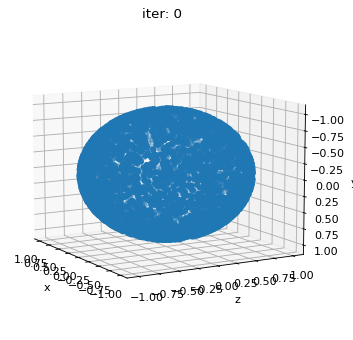

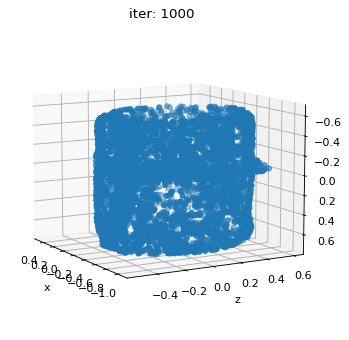

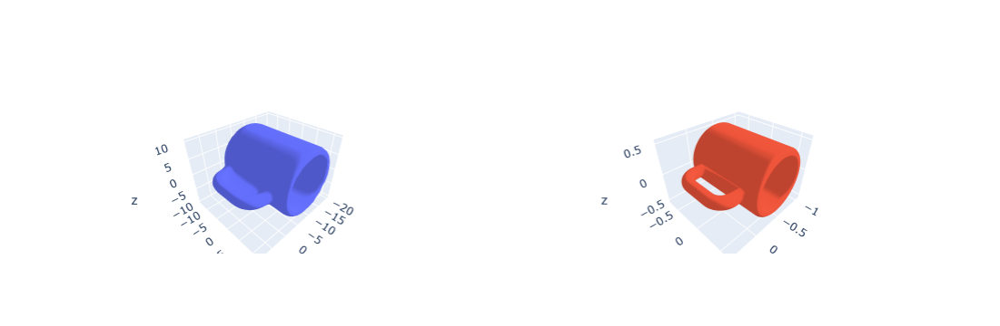

In [5]:
src_mesh = ico_sphere(4, device)

verts,faces,_=load_obj("mug.obj")
faces_idx = faces.verts_idx.to(device)
verts = verts.to(device)
centered_verts = verts-verts.mean(dim=0)#
largest_distance=centered_verts.norm(dim=1).max()
normalized_verts = centered_verts/largest_distance+torch.tensor([-0.3,0.0,0.0],device=device)
mug_mesh=Meshes([normalized_verts], [faces_idx])

final_verts, final_faces,losses10=RMSprop_opt(src_mesh,mug_mesh,1.0,1.0,0.01,0.1,2000,0.0001,0.9)
final_verts_nback = final_verts 

verts27 = final_verts_nback.detach().cpu()
faces27 = final_faces.cpu()
verts28 = mug_mesh.verts_packed().cpu()
faces28=mug_mesh.faces_packed().cpu()



In [ ]:
plotly_submeshes([[verts27,verts28]],[[faces27,faces28]],(1,2))

  0%|          | 0/4000 [00:00<?, ?it/s]

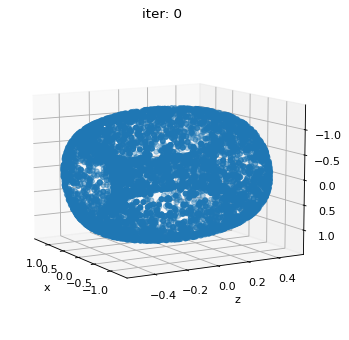

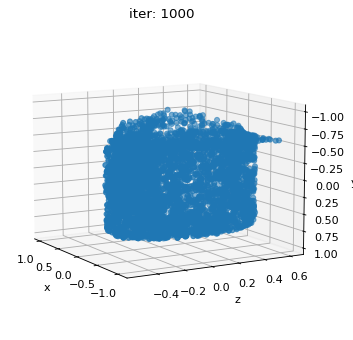

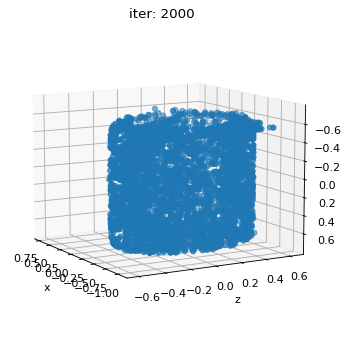

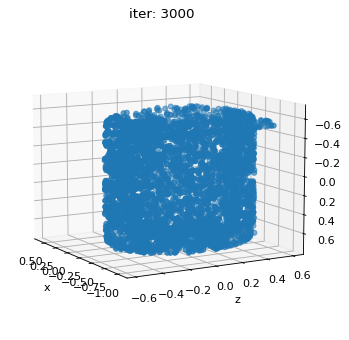

In [8]:
torus_mesh=torus(0.5,0.8,200,200,device)

final_verts, final_faces, losses11=RMSprop_opt(torus_mesh,mug_mesh,1.0,1.0,0.01,0.1,2000,0.0001,0.9)
final_verts_nback = final_verts

verts29 = final_verts_nback.detach().cpu()
faces29 = final_faces.cpu()


In [9]:
plotly_submeshes([[verts29,verts28]],[[faces29,faces28]],(1,2))

In [10]:
verts30=torus_mesh.verts_packed().cpu()
faces30=torus_mesh.faces_packed().cpu()
fig6 = go.Figure(data=[go.Mesh3d(x=verts30[:,0], y=verts30[:,1], z=verts30[:,2],i=faces30[:, 0],j=faces30[:, 1],k=faces30[:, 2],opacity=0.5),go.Mesh3d(x=verts28[:,0], y=verts28[:,1], z=verts28[:,2],i=faces28[:, 0],j=faces28[:, 1],k=faces28[:, 2],opacity=0.5)])
fig6.show()